In [1]:
df = pd.read_parquet('walmart.parquet')
df.head(1)

,weekly_sales,sid,dept,store,type,size,temperature_stdev,fuel_price_avg,fuel_price_stdev,cpi_avg,cpi_stdev,unemployment_avg,unemployment_stdev,holidayfreq
0,6,253385,5,24,1,203819,34.785,9.963135,3.499,0.268701,134.613271,2.638256,8.3645,0.126572


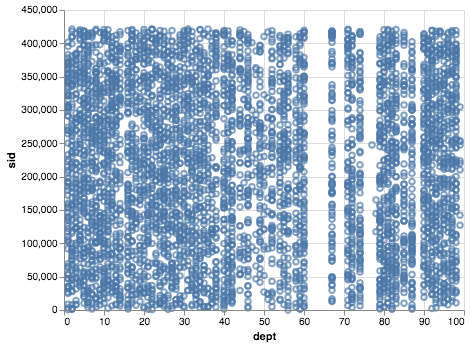

In [2]:
import altair as alt

alt.Chart(df.sample(n=5000)).mark_point().encode(x='dept', y='sid')

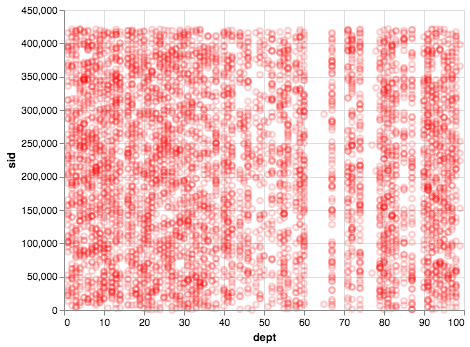

In [3]:
# Customizing Visualizations: https://altair-viz.github.io/user_guide/customization.html#customizing-visualizations
alt.Chart(df.sample(n=5000)).mark_point(opacity=0.2, color='red').encode(x='dept', y='sid')

In [4]:
# alt.Chart(df.sample(n=5000)).configure_mark(opacity=0.2, color='red').encode(x='dept', y='sid')

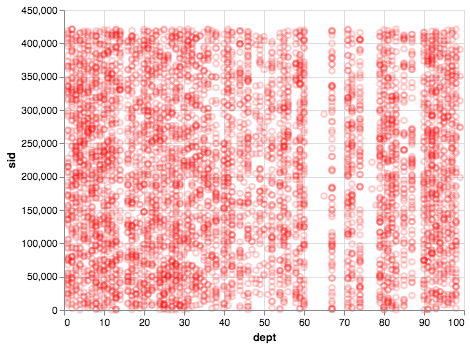

In [5]:
alt.Chart(df.sample(n=5000)).mark_point().encode(x='dept', y='sid', opacity=alt.value(0.2), color=alt.value('red'))

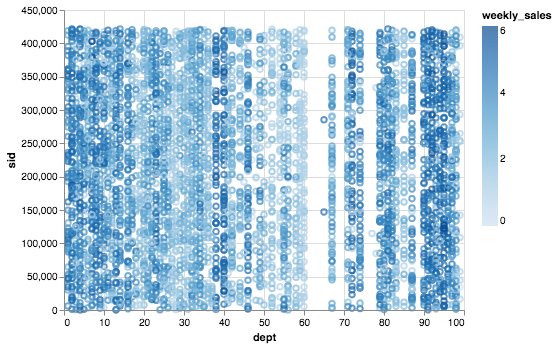

In [6]:
alt.Chart(df.sample(n=5000)).mark_point().encode(x='dept', y='sid', color='weekly_sales')

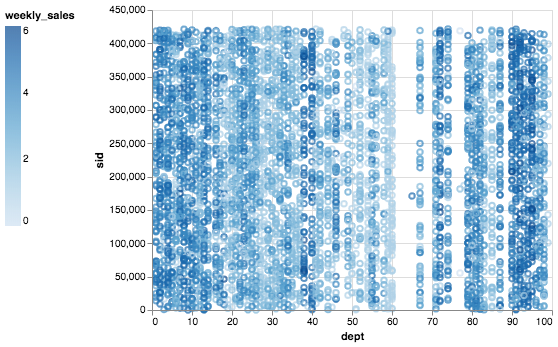

In [7]:
alt.Chart(df.sample(n=5000)).mark_point() \
    .encode(
        x='dept',
        y='sid',
        color=alt.Color('weekly_sales', legend=alt.Legend(orient="left"))
    )

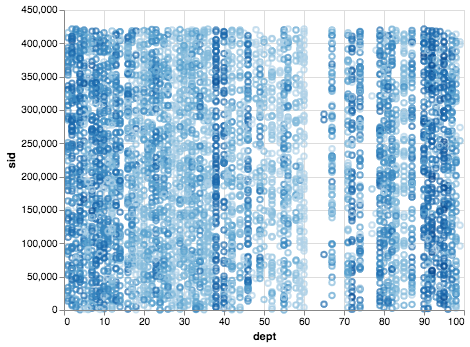

In [8]:
alt.Chart(df.sample(n=5000)).mark_point() \
    .encode(
        x='dept',
        y='sid',
        color=alt.Color('weekly_sales', legend=None)
    )

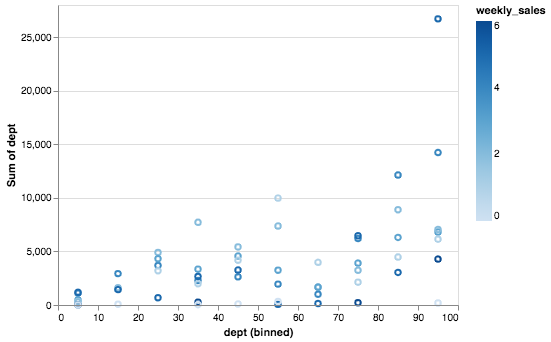

In [9]:
alt.Chart(df.sample(n=5000)).mark_point() \
    .encode(
        x=alt.X('dept', bin=alt.Bin(maxbins=10)),
        y=alt.Y('sum(dept)'),
        color=alt.Color('weekly_sales')
    )

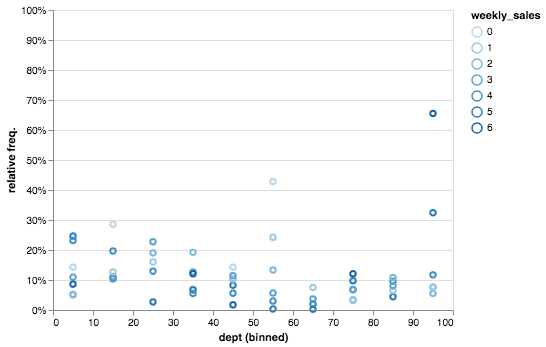

In [10]:
alt.Chart(df.sample(n=5000)).mark_point() \
    .encode(
        x=alt.X('dept:Q', bin=alt.Bin(maxbins=10)),
        y=alt.Y(
            'sum(freq):Q',
            stack=None,
            axis=alt.Axis(format='.0%'), 
            title='relative freq.', 
            scale=alt.Scale(domain=(0.0, 1.0))),
        color=alt.Color('weekly_sales:O')
    ).transform_window(
        total='count(dept)',
        frame=[None, None],
        groupby=['weekly_sales']
    ).transform_calculate(
        freq='1/datum.total'
    )

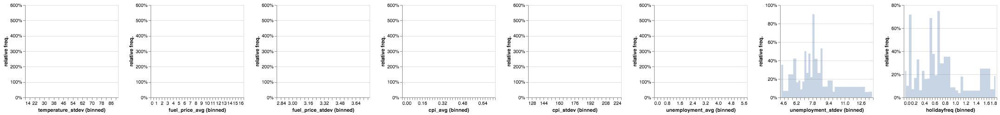

In [11]:
hists = []
chart = alt.Chart(df.sample(n=100)).mark_area(opacity=0.3, interpolate='step')

for col in df.columns:
    hist = chart.copy().encode(
        alt.X(col, bin=alt.Bin(maxbins=50)),
        alt.Y('sum(freq):Q', axis=alt.Axis(format='.0%'), title='relative freq.')
    ).transform_window(
        total='count({})'.format(col),
        frame=[None, None],
        groupby=['weekly_sales']
    ).transform_calculate(
        freq='1/datum.total'
    ).properties(width=200, height=200).interactive()
    
    if df[col].dtype in [int, float]:
        hists.append(hist)
    elif df[col].dtype == 'O':
        hists.append(hist.encode(alt.X(col)))
        
alt.hconcat(*hists)

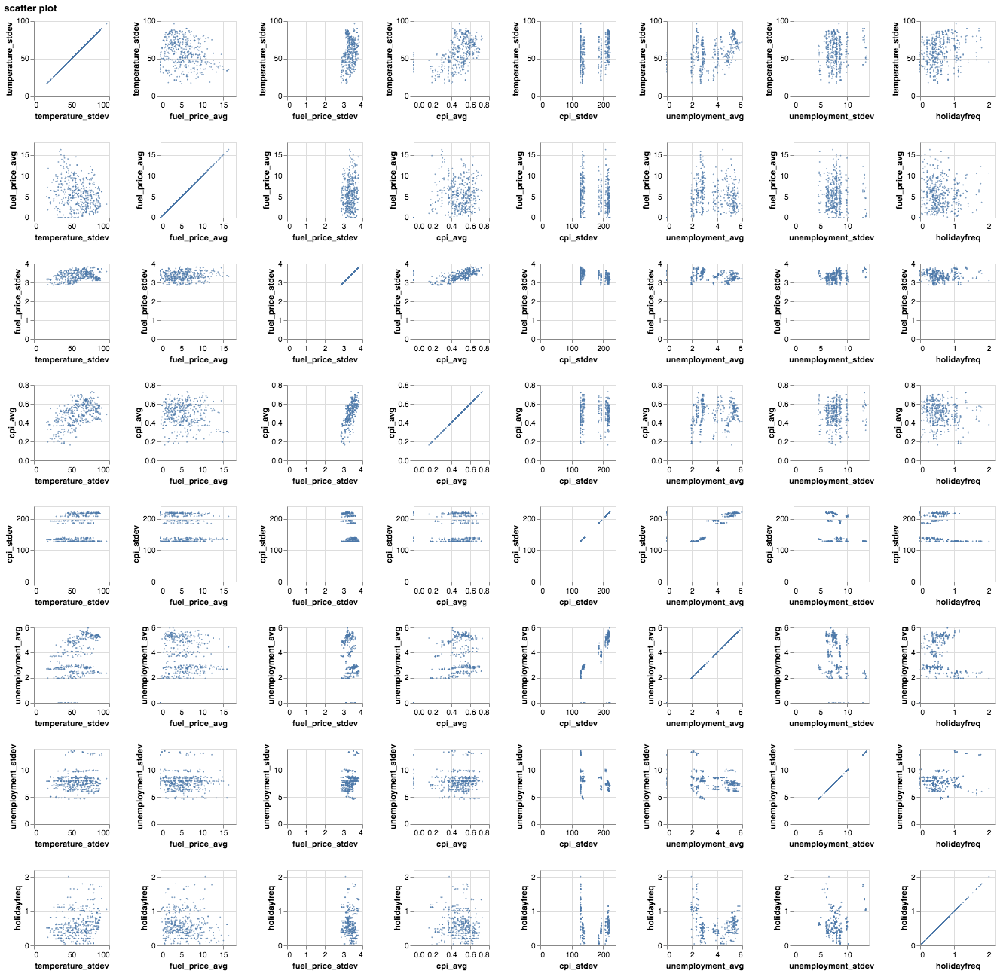

In [12]:
cols = [x for x in df.select_dtypes(include=[int, float]).columns]

alt.Chart(df.sample(n=500)).mark_circle(size=2.5).encode(
    alt.X(alt.repeat('column'), type='quantitative'),
    alt.Y(alt.repeat('row'), type='quantitative')
).properties(width=100, height=100) \
  .repeat(row=cols, column=cols) \
  .properties(title='scatter plot')

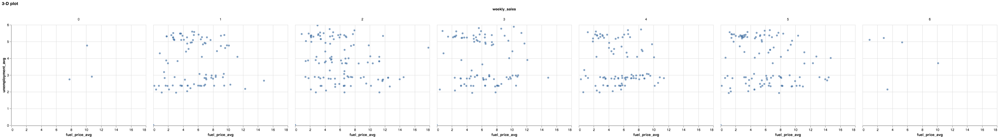

In [13]:
alt.Chart(df.sample(n=500)).mark_circle().encode(
    x='fuel_price_avg',
    y='unemployment_avg'
  ).facet(column='weekly_sales') \
    .properties(title='3-D plot') \
    .interactive()

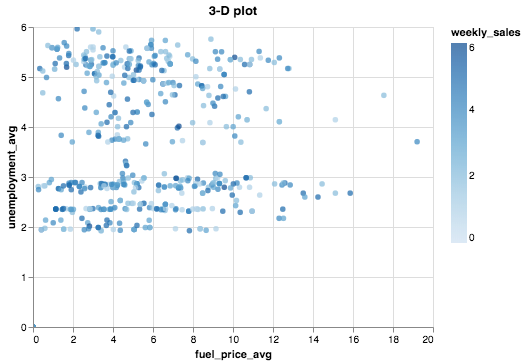

In [14]:
alt.Chart(df.sample(n=500)).mark_circle().encode(
    x='fuel_price_avg',
    y='unemployment_avg',
    color='weekly_sales'
  ).properties(title='3-D plot') \
    .interactive()

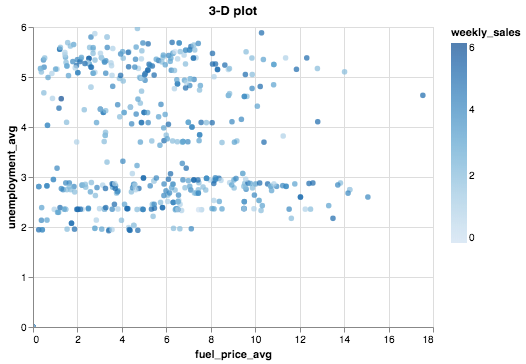

In [15]:
alt.Chart(df.sample(n=500)).mark_circle().encode(
    x=alt.X('fuel_price_avg', scale=alt.Scale(zero=False)),
    y='unemployment_avg',
    color='weekly_sales'
  ).properties(title='3-D plot') \
    .interactive()

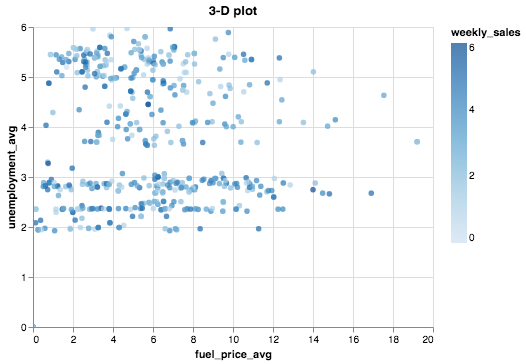

In [16]:
alt.Chart(df.sample(n=500)).mark_circle().encode(
    x=alt.X('fuel_price_avg', scale=alt.Scale(zero=False)),
    y=alt.Y('unemployment_avg', scale=alt.Scale(zero=False)),
    color='weekly_sales'
  ).properties(title='3-D plot') \
    .interactive()

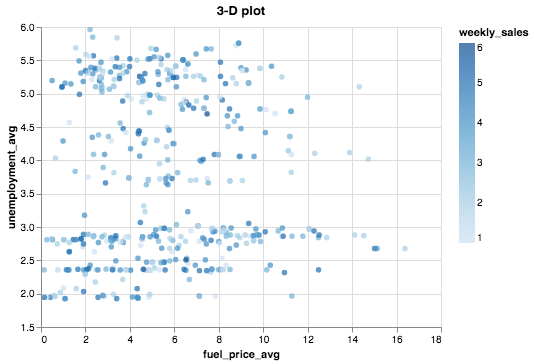

In [17]:
alt.Chart(df.sample(n=500)).mark_circle().encode(
    x=alt.X('fuel_price_avg', scale=alt.Scale(zero=False)),
    y=alt.Y('unemployment_avg', scale=alt.Scale(domain=(1.5, 6.0))),
    color='weekly_sales'
  ).properties(title='3-D plot') \
    .interactive()